Reference:
OpenStreetMap contributors, “OpenStreetMap,” OpenStreetMap. [Online]. 
Available: https://www.openstreetmap.org/

## Collect restaurant data from Yelp API

In [1]:
# upload hki.txt, kl_nt.txt, li.txt, map_hki.png, map_kl_nt.png, map_li.png to data directory
%cd "/content/drive/MyDrive/Colab/SwipEat"

/content/drive/MyDrive/Colab/SwipEat


In [2]:
import pandas as pd, numpy as np
import requests
import json
import time
import math
from google.colab import files
import matplotlib.pyplot as plt

In [3]:
from shapely.geometry import MultiPolygon, Polygon, Point

Generate equally spaced locations with latitude and longitude to search for nearby restaurant in Yelp Business Search Endpoint.

In [4]:
def parse_poly(lines):
  """
  Parse lines of latitude and longitude into polygon
  """
  coords = []
  
  for (index, line) in enumerate(lines):
    coords.append(list(map(float, line.split(', '))))

  return Polygon(coords)

In [5]:
def generate_points(filepath):
  """
  Generate equally spaced points in HK
  """
  f = open(filepath)
  polygon = parse_poly(f.readlines())
  bbox = ((min(polygon.exterior.coords.xy[0]), max(polygon.exterior.coords.xy[0]),      
         min(polygon.exterior.coords.xy[1]), max(polygon.exterior.coords.xy[1])))
  coords = []

  lat_min = min(polygon.exterior.coords.xy[1])
  lat_max = max(polygon.exterior.coords.xy[1])
  lng_min = min(polygon.exterior.coords.xy[0])
  lng_max = max(polygon.exterior.coords.xy[0])

  lng = lng_min
  lat = lat_min

  cnt = 0

  while lng <= lng_max:
    lat_cnt = 0
    while lat <= lat_max:
      coords.append([lat, lng])
      lat = lat + 0.0090437*1.3
      lat_cnt = lat_cnt + 1
    lat = lat_min
    lng = lng + 1/abs((111.32*math.cos(lat)))*1.3
    cnt = cnt + 1

  return bbox, coords, polygon

In [6]:
bbox_hki, coords_hki, polygon_hki = generate_points("data/hki.txt")
print(bbox_hki)
bbox_kl_nt, coords_kl_nt, polygon_kl_nt = generate_points("data/kl_nt.txt")
print(bbox_kl_nt)
bbox_li, coords_li, polygon_li = generate_points("data/li.txt")
print(bbox_li)

(114.1143239, 114.2628363, 22.1940172, 22.2958626)
(113.8982162, 114.4064713, 22.2377212, 22.557852)
(113.8338089, 114.06744, 22.1946862, 22.3560154)


In [7]:
df_hki = pd.DataFrame(coords_hki, columns=['latitude', 'longitude'])
df_kl_nt = pd.DataFrame(coords_kl_nt, columns=['latitude', 'longitude'])
df_li = pd.DataFrame(coords_li, columns=['latitude', 'longitude'])

In [10]:
def display_map(bbox, df, map_image_path):
  map_image = plt.imread(map_image_path)
  fig, ax = plt.subplots(figsize = (8,7))
  ax.scatter(df.longitude, df.latitude, zorder=1, alpha= 1, c='k', s=10)
  ax.set_title('Plotting Spatial Data on Map')
  ax.set_xlim(bbox[0],bbox[1])
  ax.set_ylim(bbox[2],bbox[3])
  ax.imshow(map_image, zorder=0, extent = bbox, aspect= 'equal')

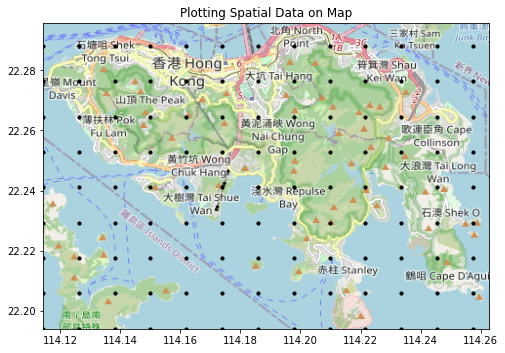

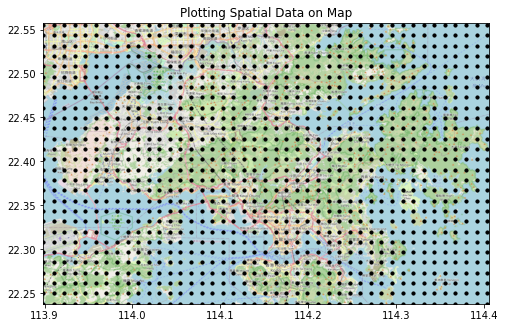

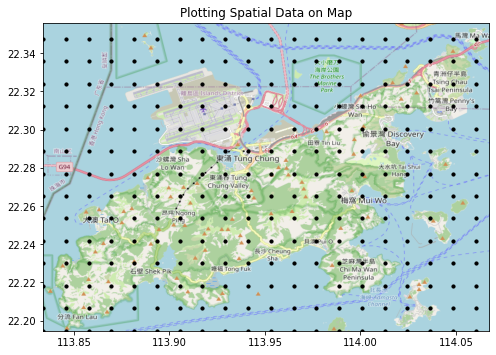

In [11]:
# map images are obtained from https://www.openstreetmap.org/export#map=11/22.3504/114.1425
map_hki_path = 'data/map_hki.png'
map_kl_nt_path = 'data/map_kl_nt.png'
map_li_path = 'data/map_li.png'
display_map(bbox_hki, df_hki, map_hki_path)
display_map(bbox_kl_nt, df_kl_nt, map_kl_nt_path)
display_map(bbox_li, df_li, map_li_path)

In [ ]:
def filter_points(df, polygon):
  """
  Drop the points that are outside of the polygons, i.e., in the sea.
  """
  rm_idx_list = []
  for i in range(df.shape[0]):
    if not polygon.contains(Point(df['longitude'][i], df['latitude'][i])):
      rm_idx_list.append(i)

  return df.drop(rm_idx_list)

In [ ]:
df_hki = filter_points(df_hki, polygon_hki)
df_kl_nt = filter_points(df_kl_nt, polygon_kl_nt)
df_li = filter_points(df_li, polygon_li)

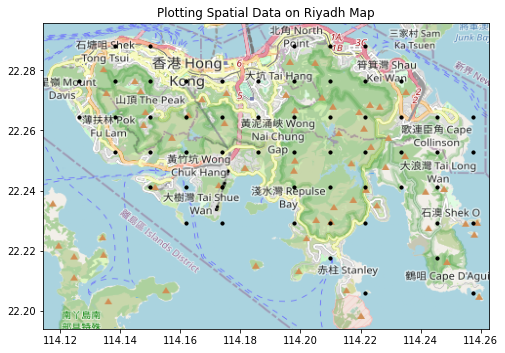

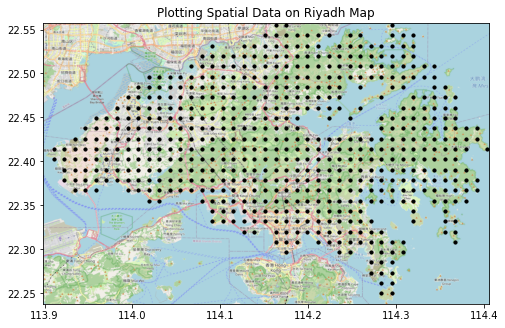

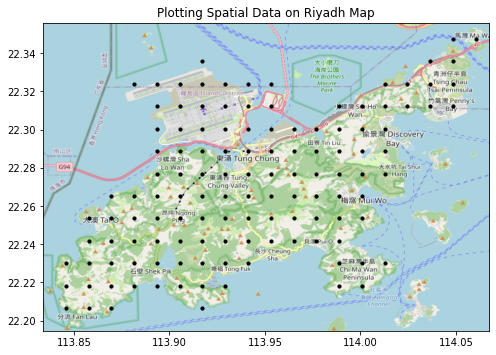

In [ ]:
display_map(bbox_hki, df_hki, map_hki_path)
display_map(bbox_kl_nt, df_kl_nt, map_kl_nt_path)
display_map(bbox_li, df_li, map_li_path)

## Yelp API

In [ ]:
# Dataframe of all the points generated
df = pd.concat([df_hki, df_kl_nt, df_li])
df = df[['latitude', 'longitude']]
df = df.reset_index()
print("Number of coordinates: ", df.shape[0])

Number of coordinates:  771


In [ ]:
from __future__ import print_function

import argparse
import json
import pprint
import requests
import sys
import urllib

In [ ]:
API_KEY= '2SqvLuEwHaCfU-vvsp3xdbW1_H4CP51EieMf5FLjKdX6J8nAPSradgt5M5-w2gPLWQG5VYJKknOaQ6VmA48ik9vvZuHIbuVJm15iq11gkdUmRl30fsnDqPglpraVYnYx' 
url = 'https://api.yelp.com/v3/businesses/search'

DEFAULT_TERM = 'restaurants'
DEFAULT_LOCATION = 'Hong Kong'
SEARCH_LIMIT = 50

def request(url_params=None):
    url_params = url_params or {}
    headers = {
        'Authorization': 'Bearer %s' % API_KEY,
    }

    response = requests.request('GET', url, headers=headers, params=url_params)

    return response.json()


def search(term, latitude, longitude, offset = 0):

    url_params = {
        'term': term.replace(' ', '+'),
        'latitude': latitude,
        'longitude': longitude,
        'limit': SEARCH_LIMIT,
        'radius': 1000,
        'offset': offset
    }

    return request(url_params=url_params)
   

In [ ]:
# fetch the restaurant data from Yelp, if the total number of restaurants in the
# location is larger than 50, iteratively fetch with offset
responses = []
total_number_fetched = 0
request_cnt = 0
for index, row in df.iterrows():
  if index >= 100:
    responses.append(search('restaurants', row['latitude'], row['longitude']))
    request_cnt = request_cnt + 1
    if index % 10 == 0:
      print(f"index: {index} request_cnt: {request_cnt}")
    total = responses[-1]['total']
    total_number_fetched = total_number_fetched + total
    offset = 50
    time.sleep(0.1)
    while offset < total and offset <= 950:
      responses.append(search('restaurants', row['latitude'], row['longitude'], offset = offset))
      request_cnt = request_cnt + 1
      offset = offset + 50
      time.sleep(0.1)

print("total number of restaurants fetched: ", total_number_fetched)

<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
index: 100 request_cnt: 1
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.com/v3/businesses/search ...
<function search at 0x7f389c6aff80>
Querying https://api.yelp.co

In [ ]:
# create list containing the data of restaurants
restaurant_list = []
for resp in responses:
  for restaurant in resp['businesses']:
    restaurant_list.append(restaurant)

In [ ]:
len(restaurant_list)

15789

In [ ]:
restaurant_list

[{'alias': 'prompt-香港',
  'categories': [{'alias': 'restaurants', 'title': 'Restaurants'}],
  'coordinates': {'latitude': 22.261902, 'longitude': 114.129596},
  'display_phone': '+852 2980 7417',
  'distance': 453.9112963241685,
  'id': 'MZq6AmHqaHnVmmSNgoX1dw',
  'image_url': 'https://s3-media2.fl.yelpcdn.com/bphoto/XKofu72v0SyGDYspMacM8g/o.jpg',
  'is_closed': False,
  'location': {'address1': '數碼港道100號數碼港艾美酒店',
   'address2': None,
   'address3': None,
   'city': 'Hong Kong',
   'country': 'HK',
   'display_address': ['Le Meridien Cyberport, 100 Cyberport Road',
    '數碼港道100號數碼港艾美酒店',
    'Hong Kong'],
   'state': 'HK',
   'zip_code': None},
  'name': 'Prompt',
  'phone': '+85229807417',
  'rating': 4.0,
  'review_count': 3,
  'transactions': [],
  'url': 'https://www.yelp.com/biz/prompt-%E9%A6%99%E6%B8%AF?adjust_creative=xyjIx3GDFlQPn3tULvgTfg&utm_campaign=yelp_api_v3&utm_medium=api_v3_business_search&utm_source=xyjIx3GDFlQPn3tULvgTfg'},
 {'alias': '姬子上海餐館-香港',
  'categories': [{'a

In [ ]:
responses[0].keys()

dict_keys(['businesses', 'total', 'region'])

In [ ]:
restaurant_list[0].keys()

dict_keys(['id', 'alias', 'name', 'image_url', 'is_closed', 'url', 'review_count', 'categories', 'rating', 'coordinates', 'transactions', 'location', 'phone', 'display_phone', 'distance'])

In [ ]:
import json
with open('yelp_responses.json', 'w') as f:
  json.dump(responses, f)

In [ ]:
# export to csv
labels_restaurant = ['id', 'alias', 'name', 'image_url', 'is_closed', 'url', 'review_count', 'categories',
                     'rating', 'coordinates', 'transactions', 'location', 'phone', 'display_phone', 'distance', 'price']
export_dataframe_restaurant = pd.DataFrame.from_records(restaurant_list, columns=labels_restaurant)
export_dataframe_restaurant.to_csv('restaurant_yelp_raw.csv', encoding='utf_8_sig', index=False)

In [ ]:
print(export_dataframe_restaurant.shape[0])
df_unique = export_dataframe_restaurant.drop_duplicates(subset=['id'])
print(df_unique.shape[0])
df_unique.to_csv('data/restaurant_yelp_unique.csv', encoding='utf_8_sig', index=False)

In [ ]:
df_unique = pd.read_csv('data/restaurant_yelp_unique.csv', encoding='utf_8_sig', index_col=False)
df_unique.head(5)

,id,alias,name,image_url,is_closed,url,review_count,categories,rating,coordinates,transactions,location,phone,display_phone,distance,price
0,MZq6AmHqaHnVmmSNgoX1dw,prompt-香港,Prompt,https://s3-media2.fl.yelpcdn.com/bphoto/XKofu7...,False,https://www.yelp.com/biz/prompt-%E9%A6%99%E6%B...,3,"[{'alias': 'restaurants', 'title': 'Restaurant...",4.0,"{'latitude': 22.261902, 'longitude': 114.129596}",[],"{'address1': '數碼港道100號數碼港艾美酒店', 'address2': No...",8.522981e+10,+852 2980 7417,453.911296,NaN
1,sU2gmbDsfcJ3Z8lYyTyw-A,姬子上海餐館-香港,Dynastie Shanghai Restaurant,https://s3-media2.fl.yelpcdn.com/bphoto/AJLmXJ...,False,https://www.yelp.com/biz/%E5%A7%AC%E5%AD%90%E4...,1,"[{'alias': 'shanghainese', 'title': 'Shanghain...",4.0,"{'latitude': 22.2604446086394, 'longitude': 11...",[],"{'address1': '數碼港道100號數碼港商場', 'address2': '3樓3...",8.522990e+10,+852 2989 6120,601.617002,NaN
2,WXPbK7gjm3VTH5WAowwGwg,delaneys-香港-3,Delaney's,https://s3-media3.fl.yelpcdn.com/bphoto/gilF_o...,False,https://www.yelp.com/biz/delaneys-%E9%A6%99%E6...,1,"[{'alias': 'irish_pubs', 'title': 'Irish Pub'}...",5.0,"{'latitude': 22.2608184090313, 'longitude': 11...",[],"{'address1': '數碼港道100號', 'address2': '314, 411...",8.522677e+10,+852 2677 1126,546.067709,NaN
3,bwY6SWOcxl2lTv2JvwrdQQ,el-charro-mexican-cantina-香港,El Charro Mexican Cantina,https://s3-media3.fl.yelpcdn.com/bphoto/13dZJx...,False,https://www.yelp.com/biz/el-charro-mexican-can...,4,"[{'alias': 'mexican', 'title': 'Mexican'}]",3.0,"{'latitude': 22.260969, 'longitude': 114.129504}",[],"{'address1': '港道100號', 'address2': '208號鋪', 'a...",8.522793e+10,+852 2793 2522,521.193099,$$
4,aCD00NbIRqAA4Wsah-ILGQ,missy-hos-香港,Missy Ho's,https://s3-media2.fl.yelpcdn.com/bphoto/7xx8sW...,False,https://www.yelp.com/biz/missy-hos-%E9%A6%99%E...,2,"[{'alias': 'international', 'title': 'Internat...",5.0,"{'latitude': 22.2813301, 'longitude': 114.1267...",[],"{'address1': '科士街48號', 'address2': '地下G9號舖', '...",8.522817e+10,+852 2817 3808,560.323260,NaN


In [ ]:
df_unique = df_unique.drop(columns=['distance', 'phone', 'transactions'])

In [ ]:
import re


def extract_name(x):
  """
  Extract the Chinese name of restaurant from alias
  """
  tmp = re.sub('-[\d]$', '', str(x))
  tmp = re.sub('-\u9999\u6e2f$', '', tmp)
  tmp = re.sub('-', ' ', tmp)

  return tmp


def flatten_dictlist(x):
  return [item['title'] for item in x if 'title' in item]


In [ ]:
df_unique['locale_name'] = df_unique['alias'].apply(extract_name)
df_unique['has_chinese_name'] = df_unique['locale_name'].apply(lambda x: True if re.search(u'[\u4e00-\u9fff]', x) else False)

In [ ]:
import ast
# convert dict saved in string to dict
df_unique['location'] = df_unique['location'].apply(lambda x: ast.literal_eval(x))
df_unique['coordinates'] = df_unique['coordinates'].apply(lambda x: ast.literal_eval(x))
df_unique['categories'] = df_unique['categories'].apply(lambda x: ast.literal_eval(x))
df_unique['categories'] = df_unique['categories'].apply(flatten_dictlist)

In [ ]:
# extract chiness address, english address
combined_addr = df_unique['location']
addr_chin = []
addr_eng = []
for addr_list in combined_addr:
  # print(addr_list['display_address'][0])
  # print(addr_list['display_address'][1])
  if len(addr_list['display_address']) == 3:
    addr_eng.append(addr_list['display_address'][0])
    addr_chin.append(addr_list['display_address'][1])
  elif len(addr_list['display_address']) == 2:
    addr_eng.append(addr_list['display_address'][0])
    addr_chin.append('')
  else:
    addr_eng.append('')
    addr_chin.append('')

df_unique['chinese_address'] = addr_chin
df_unique['english_address'] = addr_eng

In [ ]:
# extract latitude, longitude
lat_list = []
long_list = []
coords = df_unique['coordinates']
for coord in coords:
  lat_list.append(coord['latitude'])
  long_list.append(coord['longitude'])
df_unique['latitude'] = lat_list
df_unique['longitude'] = long_list

In [ ]:
categories = df_unique['categories']
tmp_list = []
for category in categories:
  for cat in category:
    tmp_list.append(cat)
print(set(tmp_list))
print(len(set(tmp_list)))

In [ ]:
df_unique.to_csv('data/restaurant_yelp_unique_refined.csv', encoding='utf_8_sig', index=False)

In [ ]:
df_unique.head(5)

,id,alias,name,image_url,is_closed,url,review_count,categories,rating,coordinates,location,display_phone,price,locale_name,has_chinese_name,chinese_address,english_address,latitude,longitude
0,MZq6AmHqaHnVmmSNgoX1dw,prompt-香港,Prompt,https://s3-media2.fl.yelpcdn.com/bphoto/XKofu7...,False,https://www.yelp.com/biz/prompt-%E9%A6%99%E6%B...,3,[Restaurants],4.0,"{'latitude': 22.261902, 'longitude': 114.129596}","{'address1': '數碼港道100號數碼港艾美酒店', 'address2': No...",+852 2980 7417,NaN,prompt,False,數碼港道100號數碼港艾美酒店,"Le Meridien Cyberport, 100 Cyberport Road",22.261902,114.129596
1,sU2gmbDsfcJ3Z8lYyTyw-A,姬子上海餐館-香港,Dynastie Shanghai Restaurant,https://s3-media2.fl.yelpcdn.com/bphoto/AJLmXJ...,False,https://www.yelp.com/biz/%E5%A7%AC%E5%AD%90%E4...,1,[Shanghainese],4.0,"{'latitude': 22.2604446086394, 'longitude': 11...","{'address1': '數碼港道100號數碼港商場', 'address2': '3樓3...",+852 2989 6120,NaN,姬子上海餐館,True,數碼港道100號數碼港商場3樓304舖,"Shop 304, 3/F, The Arcade, 100 Cyberport Road",22.260445,114.130044
2,WXPbK7gjm3VTH5WAowwGwg,delaneys-香港-3,Delaney's,https://s3-media3.fl.yelpcdn.com/bphoto/gilF_o...,False,https://www.yelp.com/biz/delaneys-%E9%A6%99%E6...,1,"[Irish Pub, Coffee & Tea, International]",5.0,"{'latitude': 22.2608184090313, 'longitude': 11...","{'address1': '數碼港道100號', 'address2': '314, 411...",+852 2677 1126,NaN,delaneys,False,"數碼港道100號314, 411, 501及601舖","Shop 314, 411, 501 & 601, 100 Cyberport Road",22.260818,114.129686
3,bwY6SWOcxl2lTv2JvwrdQQ,el-charro-mexican-cantina-香港,El Charro Mexican Cantina,https://s3-media3.fl.yelpcdn.com/bphoto/13dZJx...,False,https://www.yelp.com/biz/el-charro-mexican-can...,4,[Mexican],3.0,"{'latitude': 22.260969, 'longitude': 114.129504}","{'address1': '港道100號', 'address2': '208號鋪', 'a...",+852 2793 2522,$$,el charro mexican cantina,False,港道100號208號鋪,"Shop 208, 100 Cyberport Road",22.260969,114.129504
4,aCD00NbIRqAA4Wsah-ILGQ,missy-hos-香港,Missy Ho's,https://s3-media2.fl.yelpcdn.com/bphoto/7xx8sW...,False,https://www.yelp.com/biz/missy-hos-%E9%A6%99%E...,2,[International],5.0,"{'latitude': 22.2813301, 'longitude': 114.1267...","{'address1': '科士街48號', 'address2': '地下G9號舖', '...",+852 2817 3808,NaN,missy hos,False,科士街48號地下G9號舖,"Shop G9, G/F, 48 Forbes Street",22.281330,114.126776


## Data Display

Restaurant Name:	 El Charro Mexican Cantina
ID:			 bwY6SWOcxl2lTv2JvwrdQQ
Is Closed:		 False
Categories:		 ['Mexican']
Location (Chinese):	 港道100號208號鋪
Location (English):	 Shop 208, 100 Cyberport Road
Phone Number:		 +852 2793 2522
Latitude, Longitude:	 [22.260969, 114.129504]
Rating:			 3.0
Review Count:		 4
Price:			 $$
Website:		 https://www.yelp.com/biz/el-charro-mexican-cantina-%E9%A6%99%E6%B8%AF?adjust_creative=xyjIx3GDFlQPn3tULvgTfg&utm_campaign=yelp_api_v3&utm_medium=api_v3_business_search&utm_source=xyjIx3GDFlQPn3tULvgTfg


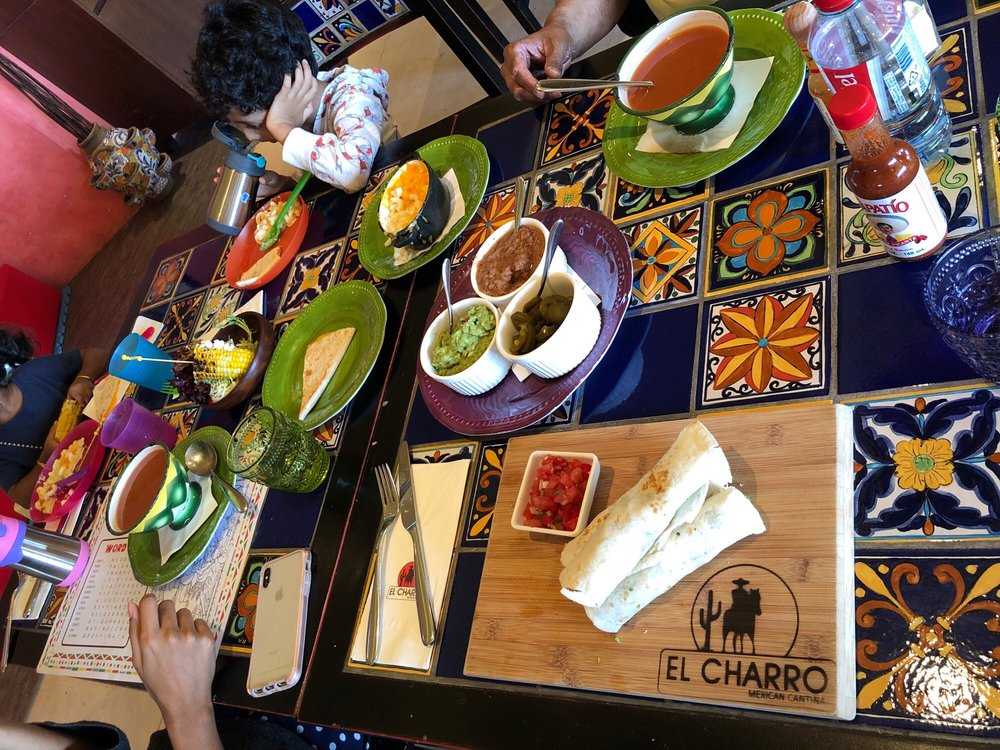

In [ ]:
from IPython.display import Image, display

idx = 3
if df_unique['has_chinese_name'][idx]:
  print('Restaurant Name:\t', df_unique['locale_name'][idx])
else:
  print('Restaurant Name:\t', df_unique['name'][idx])
print('ID:\t\t\t', df_unique['id'][idx])
print('Is Closed:\t\t', df_unique['is_closed'][idx])
print('Categories:\t\t', df_unique['categories'][idx])
if df_unique['chinese_address'][idx]:
  print('Location (Chinese):\t', df_unique['chinese_address'][idx])
print('Location (English):\t', df_unique['english_address'][idx])
print('Phone Number:\t\t', df_unique['display_phone'][idx])
print('Latitude, Longitude:\t [{lat}, {long}]'.format(lat=df_unique['latitude'][idx], long=df_unique['longitude'][idx]))
print('Rating:\t\t\t', df_unique['rating'][idx])
print('Review Count:\t\t', df_unique['review_count'][idx])
print('Price:\t\t\t', df_unique['price'][idx])
print('Website:\t\t', df_unique['url'][idx])

Image('https://s3-media3.fl.yelpcdn.com/bphoto/13dZJx5XCy8H5mn5BKPeuw/o.jpg', width = 363, height = 232)


In [ ]:
import json
f = open('yelp_responses.json')
data_json = json.load(f)

In [ ]:
data_json

[{'businesses': [{'alias': 'prompt-香港',
    'categories': [{'alias': 'restaurants', 'title': 'Restaurants'}],
    'coordinates': {'latitude': 22.261902, 'longitude': 114.129596},
    'display_phone': '+852 2980 7417',
    'distance': 453.9112963241685,
    'id': 'MZq6AmHqaHnVmmSNgoX1dw',
    'image_url': 'https://s3-media2.fl.yelpcdn.com/bphoto/XKofu72v0SyGDYspMacM8g/o.jpg',
    'is_closed': False,
    'location': {'address1': '數碼港道100號數碼港艾美酒店',
     'address2': None,
     'address3': None,
     'city': 'Hong Kong',
     'country': 'HK',
     'display_address': ['Le Meridien Cyberport, 100 Cyberport Road',
      '數碼港道100號數碼港艾美酒店',
      'Hong Kong'],
     'state': 'HK',
     'zip_code': None},
    'name': 'Prompt',
    'phone': '+85229807417',
    'rating': 4.0,
    'review_count': 3,
    'transactions': [],
    'url': 'https://www.yelp.com/biz/prompt-%E9%A6%99%E6%B8%AF?adjust_creative=xyjIx3GDFlQPn3tULvgTfg&utm_campaign=yelp_api_v3&utm_medium=api_v3_business_search&utm_source=xyjIx3GD